In [1]:
from PIL import Image
from tqdm import tqdm
import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
filenames = os.listdir("../data/sample_episode")

In [3]:
filepaths = []
for fn in filenames:
    fp = os.path.join("../data/sample_episode", fn)
    frame = int(fn.split("_")[4].lstrip("f"))
    filepaths.append((frame, fp))

In [4]:
filepaths = sorted(filepaths, key = lambda x: x[0])

In [5]:
filepaths[0]

(1,
 '../data/sample_episode/Rafael_cyj0sfke_e0_8-1_f1_a0_2019-04-13_22-43-38.fail.png')

In [6]:
im = Image.open(filepaths[0][1]).convert("RGB")

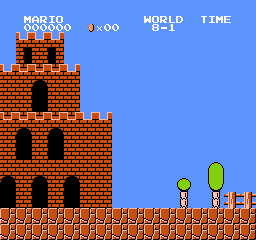

In [7]:
im

In [8]:
im.close()

In [9]:
arrs = []
for sig, fp in tqdm(filepaths):
    im = Image.open(fp).convert("RGB")
    arrs.append(
        np.array(im)
    )
    im.close()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1731/1731 [00:00<00:00, 3868.47it/s]


In [10]:
len(arrs)

1731

In [11]:
stacked_ims = np.stack(arrs)

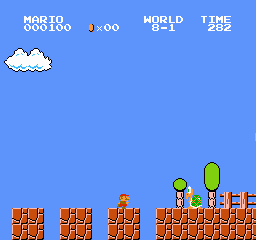

In [12]:
Image.fromarray(stacked_ims[450])

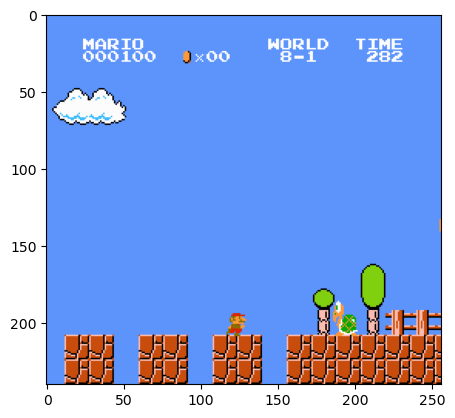

In [13]:
plt.imshow(stacked_ims[450])

In [14]:
plt.rcParams["animation.embed_limit"] = 20

Animation size has reached 21007549 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


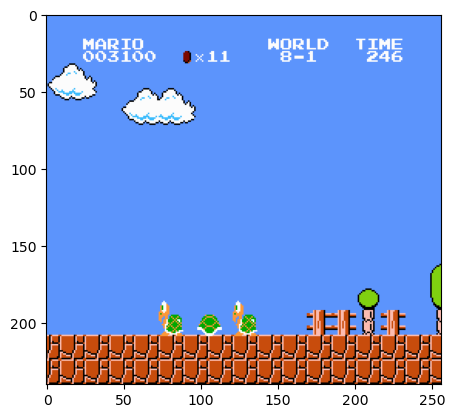

In [16]:
from IPython.display import HTML
from matplotlib import animation

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure()
im=plt.imshow(stacked_ims[0])

# initialization function: plot the background of each frame
def init():
    im.set_data(stacked_ims[0])
    return [im]

# animation function.  This is called sequentially
def animate(i):
    im.set_array(stacked_ims[i])
    return [im]

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=1731, interval=20, blit=True)

anim.save('episode_1.mp4', fps=30)

HTML(anim.to_jshtml())

In [ ]:
with open("../data/sample_episode.npy", "wb") as npy_file:
    np.save(npy_file, )